# Evaluate

In this notebook we evaluate the accuracy of the predicted alignments.

In [1]:
%matplotlib inline

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import glob
import os.path
import pandas as pd
import pickle

In [3]:
ANNOTATIONS_ROOT = Path('Chopin_Mazurkas/annotations_beat')
query_list = Path('cfg_files/query.test.list')

### Evaluate hypothesis directory

First evaluate a single hypothesis directory.

In [4]:
def eval_dir(hypdir, querylist, hop_sec, savefile = None):
    
    allErrs = {}
    cnt = 0
    print(f'Processing {hypdir} ', end='')
    with open(querylist, 'r') as f:
        for line in f:
            parts = line.strip().split()
            assert len(parts) == 2
            basename = os.path.basename(parts[0]) + '__' + os.path.basename(parts[1])
            hypfile = hypdir + '/' + basename + '.pkl'
            if not os.path.exists(hypfile):
                print("X", end='')
                continue
            allErrs[basename] = eval_file(hypfile, hop_sec)
            cnt += 1
            if cnt % 500 == 0:
                print(".", end='')
    print(' done')
    if savefile:
        pickle.dump(allErrs, open(savefile, 'wb'))
        
    return allErrs

In [5]:
def eval_file(hypfile, hop_sec):
    parts = os.path.basename(hypfile).split('__')
    assert len(parts) == 2
    piece = extractPieceName(parts[0])
    annotfile1 = (ANNOTATIONS_ROOT / piece / parts[0]).with_suffix('.beat')
    annotfile2 = (ANNOTATIONS_ROOT / piece / parts[1]).with_suffix('.beat')
    gt1 = getTimestamps(annotfile1)
    gt2 = getTimestamps(annotfile2)
    hypalign = loadAlignment(hypfile) # warping path in frames
    if hypalign is None:
        err = [] # no valid path
    else:
        pred2 = np.interp(gt1, hypalign[0,:]*hop_sec, hypalign[1,:]*hop_sec)
        err = pred2 - gt2
    return err

In [6]:
def extractPieceName(fullpath):
    basename = os.path.basename(fullpath) # e.g. Chopin_Op068No3_Sztompka-1959_pid9170b-21
    parts = basename.split('_')
    piece = '_'.join(parts[0:2]) # e.g. Chopin_Op068No3
    return piece

In [7]:
def getTimestamps(annotfile):
    df = pd.read_csv(annotfile, header=None, sep='\s+', skiprows=3)
    return np.array(df[0])

In [8]:
def loadAlignment(hypfile):
    with open(hypfile, 'rb') as f:
        d = pickle.load(f)
    return d

Evaluate a single hypothesis directory.

In [9]:
hypdir = 'experiments_test/ssdtw_2_clean'
savefile = 'evaluations_test/ssdtw_2_clean.pkl'
hop_sec = 512 * 1 / 22050
allErrs = eval_dir(hypdir, query_list, hop_sec, savefile)
print(allErrs)

Processing experiments_test/ssdtw_2_clean XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

In [10]:
hypfile = 'experiments_test/dtw_clean/Chopin_Op068No3_Sztompka-1959_pid9170b-21__Chopin_Op068No3_Uninsky-1971_pid9061b-16.pkl'
eval_file(hypfile, hop_sec)

array([-0.569025  , -0.09287986,  0.19521536, -0.01637218,  0.01741395,
        0.1801756 ,  0.01619028, -0.12624671, -0.33879824, -0.01367311,
        0.00778936, -0.08070275,  0.00092951,  0.04472816, -0.10888916,
        0.01807292,  0.01399087,  0.01040811, -0.02133799, -0.00541895,
        0.0044446 ,  0.0020186 ,  0.0041722 ,  0.38022136,  0.00614488,
       -0.19346905, -0.01353732,  0.06528329, -0.00614458,  0.04276631,
        0.0310658 ,  0.19383226, -0.01423965, -0.00852593, -0.01784526,
        0.14161075, -0.01840178, -0.32914992, -0.32040739, -0.07836739,
        0.03102042,  0.04049892, -0.03460271, -0.01789066, -0.0017234 ,
       -0.00857089,  0.02265284, -0.15204097,  0.02126983, -0.14719942,
        0.01156443,  0.03297079, -0.01165546,  0.01344633,  0.01436481,
       -0.06257348, -0.01911591, -0.00689362,  0.03249456,  0.03833873,
        0.03257391, -0.11773178,  0.00653122,  0.01088492,  0.03224506,
       -0.01836695,  0.00376443,  0.09641774, -0.01780053, -0.04

In [11]:
import glob

In [29]:
# Files = glob.glob("experiments_test/dtw_clean/*")

Files = glob.glob("experiments_test/dtw_clean/**/*.pkl", recursive = True)
Files


['experiments_test/dtw_clean/Chopin_Op024No2_Olejniczac-1990_pid9100b-11__Chopin_Op024No2_Tsujii-2005_pid9078-07.pkl',
 'experiments_test/dtw_clean/Chopin_Op063No3_Boshniakovich-1969_pid9127-06__Chopin_Op063No3_Lushtak-2004_pid9088-22.pkl',
 'experiments_test/dtw_clean/Chopin_Op063No3_Tomsic-1995_pid9190-09__Chopin_Op063No3_Uninsky-1971_pid9061b-09.pkl',
 'experiments_test/dtw_clean/Chopin_Op063No3_Indjic-1988_pid9050b-12__Chopin_Op063No3_Uninsky-1971_pid9061b-09.pkl',
 'experiments_test/dtw_clean/Chopin_Op063No3_Bacha-2000_pid9166l-10__Chopin_Op063No3_Kushner-1989_pid9118b-16.pkl',
 'experiments_test/dtw_clean/Chopin_Op068No3_Francois-1956_pid9070b-31__Chopin_Op068No3_Rubinstein-1961_pid5667285b-10.pkl',
 'experiments_test/dtw_clean/Chopin_Op063No3_Ohlsson-1999_pid9153b-12__Chopin_Op063No3_Rosenthal-1931_pid9183-11.pkl',
 'experiments_test/dtw_clean/Chopin_Op024No2_Kiepura-1999_pid9098-02__Chopin_Op024No2_Tanyel-1992_pid917813-03.pkl',
 'experiments_test/dtw_clean/Chopin_Op063No3_Frie

In [74]:
tmperror = eval_file(Files[0], hop_sec)

In [30]:
error_list = []
for file in Files:
    err = eval_file(file, hop_sec)
    error_list.append(err)
    

Evaluate all hypothesis directories.

In [12]:
def eval_all_dirs(rootdir, querylist, hop_sec, outdir):
    if not os.path.exists(outdir):
        os.mkdir(outdir)
    for hypdir in glob.glob(f'{rootdir}/dtw_clean/*'):
        savefile = outdir + '/' + os.path.basename(hypdir)
        allErrs = eval_dir(hypdir, querylist, hop_sec, savefile = savefile)

In [41]:
EXPERIMENTS_ROOT = 'experiments_test'
hop_sec = 512 * 1 / 22050
outdir = 'evaluations_test/dtw_clean2'
eval_all_dirs(EXPERIMENTS_ROOT, query_list, hop_sec, outdir)

Processing experiments_test/dtw_clean/Chopin_Op024No2_Olejniczac-1990_pid9100b-11__Chopin_Op024No2_Tsujii-2005_pid9078-07.pkl XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX

KeyboardInterrupt: 

### Plot error vs tolerance

In [15]:
def calc_error_rates(allErrs, maxTol):
    
    # # read from file
    # with open(errFile, 'rb') as f:
    #     allErrs = pickle.load(f)
    
    # collect all errors
    errsFlat = []
    for query in allErrs:
        # errs = np.array(query)
        errsFlat.append(query)
    # print(errsFlat)
    # errsFlat = np.concatenate(errsFlat)
    
    # calculate error rates
    errRates = np.zeros(maxTol+1)
    for i in range(maxTol+1):
        errRates[i] = np.mean(np.abs(errsFlat) > i/1000)
    
    return errRates, errsFlat

In [16]:
error_list[0][25]

-0.026519344671202205

In [66]:
maxTol = 1000 # in msec
calc_error_rates(error_list[0], maxTol)


(array([1.        , 0.97222222, 0.93611111, ..., 0.        , 0.        ,
        0.        ]),
 [0.008684947845805091,
  0.02390013605442176,
  -0.02875317800453514,
  0.02073689115646271,
  -0.003560090702948049,
  0.02421703401360542,
  -0.014852467120181512,
  -0.017234058956915987,
  -0.02707490022675696,
  0.048299319727891366,
  -0.03816368027210881,
  0.014739229024943512,
  0.0002268310657607131,
  0.007596217687074969,
  0.0029024693877568453,
  0.013787149659867382,
  0.04984169387755255,
  0.009172265306121474,
  -0.011678074829933216,
  -0.009660210884354647,
  -0.03977376870748195,
  0.010011267573695193,
  -0.011983913832199988,
  0.013990859410430545,
  -0.01473929931972684,
  -0.026519344671202205,
  -0.021632639455782865,
  0.005782312925168398,
  -0.023957070294784444,
  0.0027096802721082724,
  -0.026870607709749805,
  -0.0015306825396823598,
  -0.0021087029478454866,
  -0.0011111814058946123,
  -0.10509020408163217,
  -0.00035154421768623934,
  -0.001031816326531043

In [17]:
def calc_error_rates_batch(indir, basenames, maxTol):
    errRates = np.zeros((len(basenames), maxTol+1))
    allErrVals = []
    print('Computing error rates ', end='')
    for i, basename in enumerate(basenames):
        # errFile = indir + '/' + basename + '.pkl'
        errFile =basename 
        errRates[i,:], errors = calc_error_rates(errFile, maxTol)
        allErrVals.append(errors)
        print('.', end='')
    print(' done')
    return errRates, allErrVals

In [18]:
def plot_multiple_roc(errRates, basenames):
    numSystems = errRates.shape[0]
    maxTol = errRates.shape[1] - 1
    for i in range(numSystems):
        plt.plot(np.arange(maxTol+1), errRates[i,:] * 100.0)
    plt.legend(basenames, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.xlabel('Error Tolerance (ms)')
    plt.ylabel('Error Rate (%)')
    plt.show()
    return

In [31]:
allErrVals = []
maxTol = 1000 # in msec
errRates = np.zeros((len(error_list), maxTol+1))
for i, errFile in enumerate(error_list):
        errRates[i,:], errors = calc_error_rates(errFile, maxTol)
        allErrVals.append(errors)



/home/jperez/ttmp/anaconda/envs/E207enviro/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/jperez/ttmp/anaconda/envs/E207enviro/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [23]:
toPlot = ['dtw_clean']


In [21]:
EVAL_ROOT_DIR = ''

toPlot = ['dtw_clean']
Files = glob.glob("evaluations_test/dtw_clean2/*")

maxTol = 1000 # in msec
errRates, errVals = calc_error_rates_batch(EVAL_ROOT_DIR, Files, maxTol)

Computing error rates evaluations_test/dtw_clean2/Chopin_Op024No2_Olejniczac-1990_pid9100b-11__Chopin_Op024No2_Tsujii-2005_pid9078-07.pkl
{}


ValueError: need at least one array to concatenate

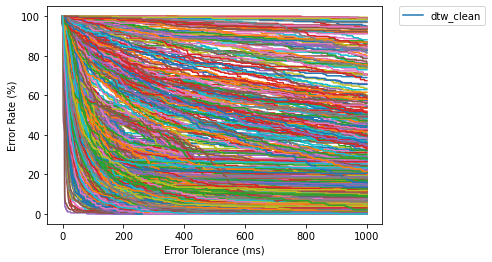

In [32]:
plot_multiple_roc(errRates, toPlot)

### Histogram of selected error rates

In [25]:
def plot_grouped_histogram1(errRates, basenames, tols):  
    # Histogram grouped by tolerance
    
    # first construct DataFrame
    data = []
    for i, system in enumerate(basenames):
        for tol in tols:
            data.append((system, tol, errRates[i,tol] * 100.0))
    df = pd.DataFrame(data, columns = ['System', 'Tolerance', 'Error'])
    
    # grouped barplot
    sns.barplot(x="Tolerance", y="Error", hue="System", data=df)
    plt.xlabel("Tolerance (ms)", size=14)
    plt.ylabel("Error Rate", size=14)
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.show()
    
    return

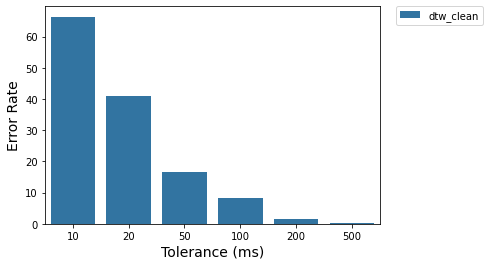

In [26]:
tols = [10, 20, 50, 100, 200, 500] # in msec
plot_grouped_histogram1(errRates, toPlot, tols)

### Final results plot for paper

This one is touched up to look nicer.

In [27]:
def plot_grouped_histogram1(errRates_bars, errRates_dots, basenames, tols, savefile = None):  
    # Histogram grouped by tolerance
    
    # first construct DataFrame
    data = []
    for i, system in enumerate(basenames):
        for tol in tols:
            data.append((system, tol, errRates[i,tol] * 100.0))
    df = pd.DataFrame(data, columns = ['System', 'Tolerance', 'Error'])
    
    # grouped barplot (DTW & WSDTW)
    sns.barplot(x="Tolerance", y="Error", hue="System", data=df)
    plt.xlabel("Tolerance (ms)", size=14)
    plt.ylabel("Error Rate (%)", size=14)
    #plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    plt.legend(loc='upper right')
    
    # overlay dots for SSDTW results
    width_bar = .135
    x_coords = []
    y_coords = []
    for i, tol in enumerate(tols):
        for j in range(errRates_dots.shape[0]):
            x_coords.append(i+(-1.5+j)*width_bar)
            y_coords.append(errRates_dots[j,tol] * 100.0)
    plt.plot(x_coords, y_coords, 'ko', markersize=3)
    
    if savefile:
        plt.savefig(savefile, bbox_inches = 'tight')
    
    return

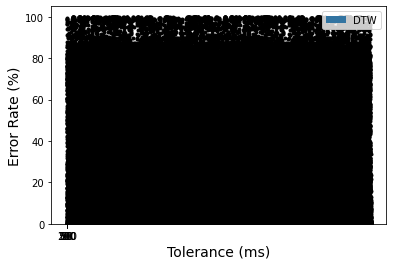

In [28]:
tols = [10, 20, 50, 100, 200, 500] # in msec
display_names = ['DTW']
savefile = 'results.png'
plot_grouped_histogram1(errRates[0:6,:], errRates[6:,:], display_names, tols, savefile)

### Runtime Analysis

In [ ]:
dtw_runtimes, dtw_sizes = pickle.load(open('dtw_prof.pkl', 'rb'))
# wsdtw_runtimes, wsdtw_segments, wsdtw_sizes = pickle.load(open('wsdtw_prof.pkl', 'rb'))
# ssdtw_runtimes, ssdtw_segments, ssdtw_sizes = pickle.load(open('ssdtw_prof.pkl', 'rb'))

Numbers for runtime table

In [ ]:
dtw_avgs = np.mean(np.sum(dtw_runtimes[::-1,:,:], axis=2), axis=1)

In [ ]:
# wsdtw_avgs = np.mean(np.sum(wsdtw_runtimes[:,::-1,:,:], axis=3), axis=2)

In [ ]:
# ssdtw_avgs = np.mean(np.sum(ssdtw_runtimes[:,::-1,:,:], axis=3), axis=2)

In [ ]:
# all_avgs = np.vstack((dtw_avgs.reshape((1,-1)), wsdtw_avgs, ssdtw_avgs))

In [ ]:
# first row: DTW
# next 5 rows: WSDTW with segments = 2, 4, 8, 16, 32
# next 5 rows: SSDTW with segments = 2, 4, 8, 16, 32
dtw_avgs

Breakdown of runtime by component

In [ ]:
# get DTW percent of total runtime by component
dtw_avgs = np.mean(dtw_runtimes, axis=1)
dtw_avgs = dtw_avgs / np.sum(dtw_avgs, axis=1, keepdims=True) * 100.0
dtw_avgs = dtw_avgs[::-1,:]
dtw_avgs = np.hstack((dtw_avgs, np.zeros((6,2)))) # order: cost, frm dp, frm back, seg dp, seg back
dtw_df = pd.DataFrame(dtw_avgs, columns=['Cost', 'Frm DP', 'Frm Back','Seg DP', 'Seg Back'], index=dtw_sizes[::-1])

In [ ]:
# # get WSDTW percent of total runtime by component
# wsdtw_avgs = np.mean(wsdtw_runtimes, axis=2)
# wsdtw_avgs = wsdtw_avgs / np.sum(wsdtw_avgs, axis=2, keepdims=True) * 100.0
# wsdtw_avgs = wsdtw_avgs[4,::-1,:] # focus on K=32 segments
# wsdtw_avgs = wsdtw_avgs[:,[0,1,4,2,3]] # original order: cost, frm dp, seg dp, seg back, frm back
# wsdtw_df = pd.DataFrame(wsdtw_avgs, columns=['Cost', 'Frm DP', 'Frm Back','Seg DP', 'Seg Back'], index=wsdtw_sizes[::-1])

In [ ]:
# # get SSDTW percent of total runtime by component
# ssdtw_avgs = np.mean(ssdtw_runtimes, axis=2)
# ssdtw_avgs = ssdtw_avgs / np.sum(ssdtw_avgs, axis=2, keepdims=True) * 100.0
# ssdtw_avgs = ssdtw_avgs[4,::-1,:] # focus on K=32 segments
# ssdtw_avgs[:,2] = ssdtw_avgs[:,2] + ssdtw_avgs[:,5] # combine runtimes from both frame-level backtracking stages
# ssdtw_avgs = ssdtw_avgs[:,0:5] # order: cost, frm dp, frm back, seg dp, seg back
# ssdtw_df = pd.DataFrame(ssdtw_avgs, columns=['Cost', 'Frm DP', 'Frm Back','Seg DP', 'Seg Back'], index=ssdtw_sizes[::-1])

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3)

# DTW plot
ax = dtw_df.plot(kind="bar", stacked=True, colormap="rainbow", ax=axes[0])
ax.set_title("DTW")
ax.set_ylabel("% Total Runtime", size=13),
ax.set_ylim(0, 100)
ax.set_yticks(range(0, 101, 10))
ax.xaxis.set_ticks_position('none') 
ax.set_xticklabels(labels=['1k','2k','5k','10k','20k','50k'], rotation=90, minor=False)
ax.get_legend().remove()

# # Segmental DTW plot
# ax = wsdtw_df.plot(kind="bar", stacked=True, colormap="rainbow", ax=axes[1])
# ax.set_title("WSDTW-32")
# ax.set_xlabel("\nCost Matrix Size", size=13),
# ax.set_ylim(0, 100)
# ax.set_yticks([])
# ax.xaxis.set_ticks_position('none') 
# ax.set_xticklabels(labels=['1k','2k','5k','10k','20k','50k'], rotation=90, minor=False)
# ax.get_legend().remove()

# # Par DTW plot
# ax = ssdtw_df.plot(kind="bar", stacked=True, colormap="rainbow", ax=axes[2])
# ax.set_title("SSDTW-32")
# ax.set_ylim(0, 100)
# ax.set_yticks([])
# ax.xaxis.set_ticks_position('none') 
# ax.set_xticklabels(labels=['1k','2k','5k','10k','20k','50k'], rotation=90, minor=False)

# ax.legend(bbox_to_anchor=(1, 1))

plt.show()
#plt.savefig('runtime.png', bbox_inches = 'tight')

### Data Stats for paper

Collecting some stats on the audio data

In [ ]:
root_dir = 'Chopin_Mazurkas/wav_22050_mono'

In [ ]:
def printAudioStats(indir):
    durs = []
    for infile in glob.glob(f'{indir}/*.wav'):
        y, sr = lb.load(infile)
        durs.append(len(y)/sr)
    durs = np.array(durs)
    
    print(os.path.basename(indir))
    print('---------')
    print(f'Min: {np.min(durs)} s')
    print(f'Max: {np.max(durs)} s')
    print(f'Mean: {np.mean(durs)} s')
    print(f'Std: {np.std(durs)} s')

In [ ]:
for indir in glob.glob(f'{root_dir}/*'):
    printAudioStats(indir)